In [1]:
import importlib
import pickle
from pathlib import Path
import matplotlib.patches as mpatches

import matplotlib.colors as colors
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
from scipy.spatial import KDTree
from scipy.stats._continuous_distns import norm
from sklearn.metrics.pairwise import euclidean_distances
from statsmodels.distributions.empirical_distribution import ECDF
from scipy.stats import gaussian_kde
from matplotlib.lines import Line2D

import exposure_series as es
import mstmeclass as mc
from mstmeclass import MSTME, SIMSET, STM

In [14]:
import dill

In [2]:
ds=xr.load_dataset(f"./data/exp_series/{34:03d}.nc")


In [3]:
import matplotlib.dates as mdates

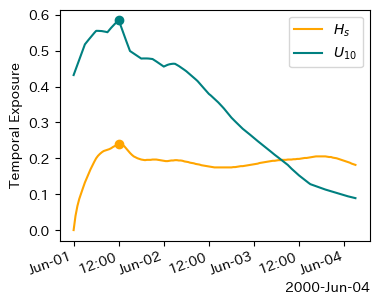

In [5]:
nni=0
fig,ax=plt.subplots(1,1,figsize=(4,3),facecolor='white')
ni=20457+nni
x=ds['time']
yh=ds['hs'].isel(node=ni)
yu=ds['UV_10m'].isel(node=ni)
idx_h=yh.argmax()
idx_u=yu.argmax()
ax.plot(x,yh,c='orange',label=STM.H.name())
ax.plot(x,yu,c='teal',label=STM.U.name())

ax.scatter(x[idx_h],yh[idx_h],c='orange')
ax.scatter(x[idx_u],yu[idx_u],c='teal')

ax.xaxis.set_major_formatter(
    mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
for label in ax.get_xticklabels(which='major'):
    label.set(rotation=20, horizontalalignment='right')
ax.set_ylabel('Temporal Exposure')
ax.legend()
plt.savefig('./output/common/active/example_exposure_series.png',bbox_inches='tight')
plt.savefig('./output/common/active/example_exposure_series.pdf',bbox_inches='tight')

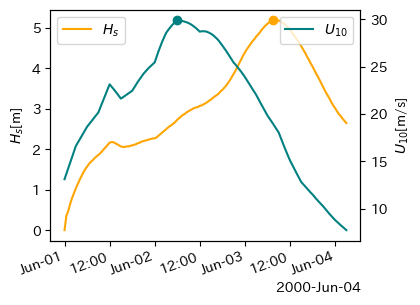

In [ ]:
fig,ax1=plt.subplots(1,1,figsize=(4,3),facecolor='white')


mstm=[15,45]
ax1.plot(x,mstm[0]*yh,c='orange',label=STM.H.name())
ax2=ax1.twinx()
ax2.plot(x,mstm[1]*yu,c='teal',label=STM.U.name())

ax1.scatter(x[idx_h],mstm[0]*yh[idx_h],c='orange')
ax2.scatter(x[idx_u],mstm[1]*yu[idx_u],c='teal')


ax1.xaxis.set_major_formatter(
    mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
for label in ax1.get_xticklabels(which='major'):
    label.set(rotation=20, horizontalalignment='right')
ax1.legend()
ax2.legend()
ax1.set_ylabel(f"{STM.H.name()}[{STM.H.unit()}]")
ax2.set_ylabel(f"{STM.U.name()}[{STM.U.unit()}]")
plt.savefig('./output/common/active/example_series.png',bbox_inches='tight')
plt.savefig('./output/common/active/example_series.pdf',bbox_inches='tight')

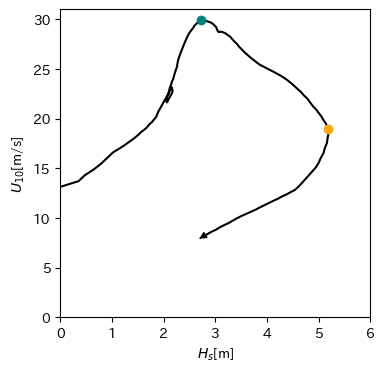

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4), facecolor="white")
ax.set_xlim(0,6)
ax.set_ylim(0,31
            
            )
ax.plot(mstm[0] * yh[:-3], mstm[1] * yu[:-3], c="k", zorder=-1)
ax.annotate(
    "",
    xy=(mstm[0] * yh[-1],mstm[1] * yu[-1]),
    xytext=(mstm[0] * yh[-3],mstm[1] * yu[-3]),
    arrowprops=dict(arrowstyle="-|>",fc='k')
)
ax.scatter(mstm[0] * yh[idx_h], mstm[1] * yu[idx_h], c="orange")
ax.scatter(mstm[0] * yh[idx_u], mstm[1] * yu[idx_u], c="teal")
ax.set_xlabel(f"{STM.H.name()}[{STM.H.unit()}]")
ax.set_ylabel(f"{STM.U.name()}[{STM.U.unit()}]")
plt.savefig('./output/common/active/example_series_2d.png',bbox_inches='tight')
plt.savefig('./output/common/active/example_series_2d.pdf',bbox_inches='tight')

In [ ]:
mstme_condition.stm.data[:,0:3].T

array([[13.5     ,  5.56    ,  8.11    ],
       [43.79    , 23.359999, 22.24    ]], dtype=float32)

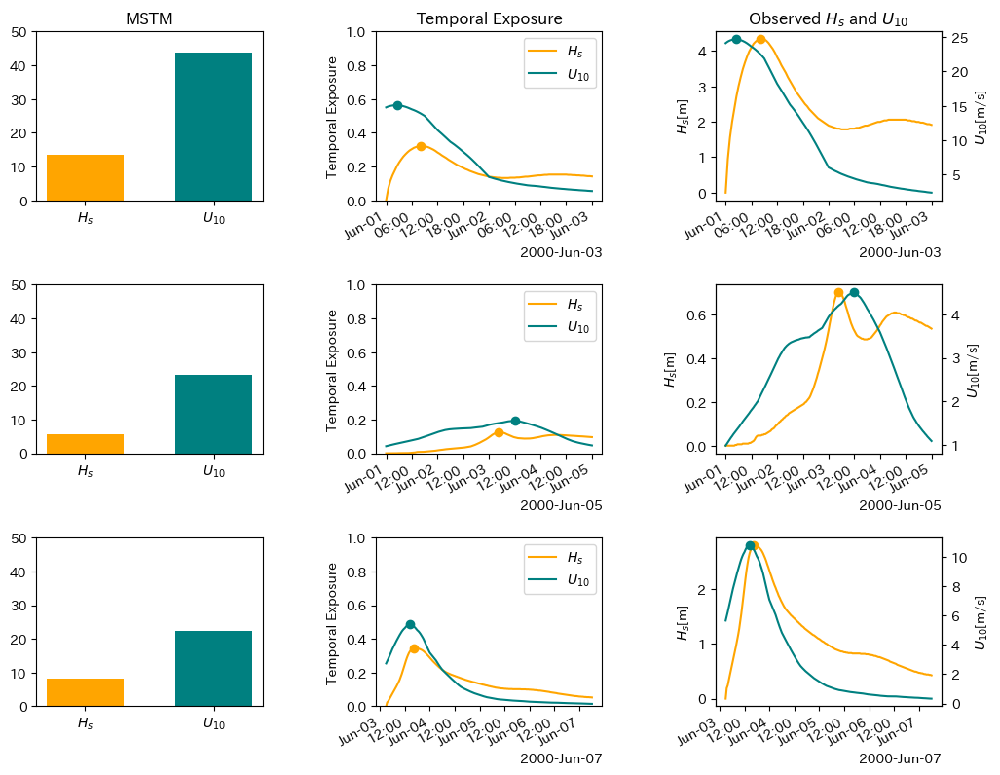

In [ ]:
fig,axes=plt.subplots(3,3,figsize=(4*3,3*3),)
fig.subplots_adjust(hspace=0.5,wspace=0.5)
mstm_list=mstme_condition.stm.data[:,0:3].T
axes[0,0].set_title('MSTM')
axes[0,1].set_title('Temporal Exposure')
axes[0,2].set_title('Observed $H_s$ and $U_{10}$')

for i in range(3):
    ds=xr.load_dataset(f"./data/exp_series/{i:03d}.nc")
    ni=20569+nni*i
    x=ds['time']
    yh=ds['hs'].isel(node=ni)
    yu=ds['UV_10m'].isel(node=ni)
    idx_h=yh.argmax()
    idx_u=yu.argmax()
    mstm=mstm_list[i]
    
    ##
    axes[i,0].set_ylim(0,50)
    axes[i,0].bar(  
    [STM.H.name(),STM.U.name()],
        height=mstm, 
        width=0.6,
        color=['orange','teal']
    )


    ##
    axes[i,1].set_ylim(0,1)
    axes[i,1].plot(x,yh,c='orange',label=STM.H.name())
    axes[i,1].plot(x,yu,c='teal',label=STM.U.name())

    axes[i,1].scatter(x[idx_h],yh[idx_h],c='orange')
    axes[i,1].scatter(x[idx_u],yu[idx_u],c='teal')

    axes[i,1].xaxis.set_major_formatter(
        mdates.ConciseDateFormatter(axes[i,1].xaxis.get_major_locator()))
    for label in axes[i,1].get_xticklabels(which='major'):
        label.set(rotation=30, horizontalalignment='right')
    axes[i,1].set_ylabel('Temporal Exposure')
    axes[i,1].legend()

    ##
    axes[i,2].plot(x,mstm[0]*yh,c='orange',label=STM.H.name())
    ax2=axes[i,2].twinx()
    ax2.plot(x,mstm[1]*yu,c='teal',label=STM.U.name())

    axes[i,2].scatter(x[idx_h],mstm[0]*yh[idx_h],c='orange')
    ax2.scatter(x[idx_u],mstm[1]*yu[idx_u],c='teal')


    axes[i,2].xaxis.set_major_formatter(
        mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
    for label in axes[i,2].get_xticklabels(which='major'):
        label.set(rotation=30, horizontalalignment='right')
    # axes[i,2].legend()
    # ax2.legend()
    axes[i,2].set_ylabel(f"{STM.H.name()}[{STM.H.unit()}]")
    ax2.set_ylabel(f"{STM.U.name()}[{STM.U.unit()}]")
plt.savefig('./output/common/active/example_3_events.png',bbox_inches='tight')
plt.savefig('./output/common/active/example_3_events.pdf',bbox_inches='tight')

C:\Users\Kosuke\AppData\Local\Temp\ipykernel_10784\710954315.py:8: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


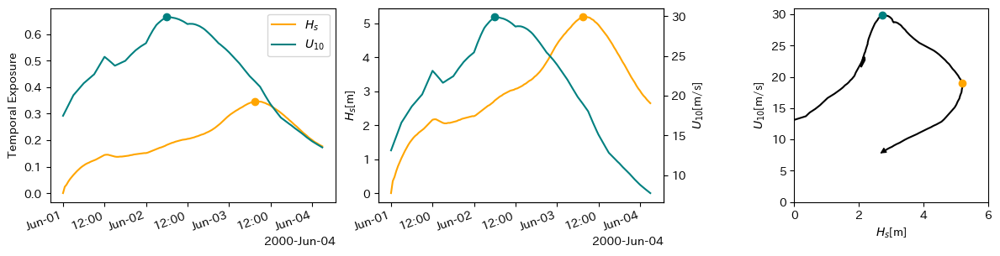

In [ ]:
fig, axes = plt.subplots(
    1,
    4,
    figsize=(4 * 3, 3),
    facecolor="white",
    gridspec_kw=dict(width_ratios=[6, 6, 0, 6],wspace=0.2),
)
fig.tight_layout()
fig.subplots_adjust(right=1.1)
axes[2].remove()
ni = 20457 + nni
x = ds["time"]
yh = ds["hs"].isel(node=ni)
yu = ds["UV_10m"].isel(node=ni)
idx_h = yh.argmax()
idx_u = yu.argmax()

###
axes[0].plot(x, yh, c="orange", label=STM.H.name())
axes[0].plot(x, yu, c="teal", label=STM.U.name())

axes[0].scatter(x[idx_h], yh[idx_h], c="orange")
axes[0].scatter(x[idx_u], yu[idx_u], c="teal")

axes[0].xaxis.set_major_formatter(
    mdates.ConciseDateFormatter(axes[0].xaxis.get_major_locator())
)
for label in axes[0].get_xticklabels(which="major"):
    label.set(rotation=20, horizontalalignment="right")
axes[0].set_ylabel("Temporal Exposure")
axes[0].legend()

###
mstm = [15, 45]
axes[1].plot(x, mstm[0] * yh, c="orange", label=STM.H.name())
ax2 = axes[1].twinx()
ax2.plot(x, mstm[1] * yu, c="teal", label=STM.U.name())

axes[1].scatter(x[idx_h], mstm[0] * yh[idx_h], c="orange")
ax2.scatter(x[idx_u], mstm[1] * yu[idx_u], c="teal")


axes[1].xaxis.set_major_formatter(
    mdates.ConciseDateFormatter(ax.xaxis.get_major_locator())
)
for label in axes[1].get_xticklabels(which="major"):
    label.set(rotation=20, horizontalalignment="right")
# axes[1].legend()
# ax2.legend()
axes[1].set_ylabel(f"{STM.H.name()}[{STM.H.unit()}]")
ax2.set_ylabel(f"{STM.U.name()}[{STM.U.unit()}]")

###
axes[3].set_aspect(6/31)
axes[3].set_xlim(0, 6)
axes[3].set_ylim(0, 31)
axes[3].plot(mstm[0] * yh[:-3], mstm[1] * yu[:-3], c="k", zorder=-1)
axes[3].annotate(
    "",
    xy=(mstm[0] * yh[-1], mstm[1] * yu[-1]),
    xytext=(mstm[0] * yh[-3], mstm[1] * yu[-3]),
    arrowprops=dict(arrowstyle="-|>", fc="k"),
)
axes[3].scatter(mstm[0] * yh[idx_h], mstm[1] * yu[idx_h], c="orange")
axes[3].scatter(mstm[0] * yh[idx_u], mstm[1] * yu[idx_u], c="teal")
axes[3].set_xlabel(f"{STM.H.name()}[{STM.H.unit()}]")
axes[3].set_ylabel(f"{STM.U.name()}[{STM.U.unit()}]")

plt.savefig('./output/common/active/example_series_combined.png',bbox_inches='tight')
plt.savefig('./output/common/active/example_series_combined.pdf',bbox_inches='tight')

# Load data

In [4]:
simset = SIMSET("guadeloupe-wide", "h-east", -100)
thr_pct_mar = 60
thr_pct_com = 90

# get stm from previous result
path_condition = Path(f"./output/{simset.region}/{simset.rf}/GP{thr_pct_mar}%_CM{thr_pct_com}%_100subsamples")
with open(path_condition / "mstme_condition.dill", "rb") as f:
    mstme:MSTME = pickle.load(f)
stm = mstme.stm
num_events = mstme.num_events
num_vars = mstme.num_vars

# load in one dataset for filtering NaNs
_ds = xr.open_dataset(f"./data/exp_series/000.nc")
_ds = _ds.dropna(dim='node')
_, latitude, longitude = _ds.coords.values()
tree = KDTree(np.array([latitude,longitude]).T)
grid_res = 10
lat_list = np.linspace(simset.min_lat, simset.max_lat, grid_res)
lon_list = np.linspace(simset.min_lon, simset.max_lon, grid_res)
grid_latlon_list = np.array(np.meshgrid(lat_list,lon_list)).reshape((2,grid_res**2)).T
dist_list, pos_list = tree.query(grid_latlon_list)
pos_list = pos_list.flatten()
mask = mstme.mask
paths = [Path(f"./data/exp_series/{i:03d}.nc") for i in mask.nonzero()[0]]
ds_exp_series = es.load_data(paths, mask, pos_list)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [5]:
_, pos_list_5loc = KDTree(np.array([latitude[pos_list],longitude[pos_list]]).T).query(    [
        [16.5,-61.8],
        [16.0,-61.9],
        [16.05,-61.4],
        [16.0,-61.0],
        [16.5,-61.1],
    ])

In [6]:
res = 10
di = 0
dist_method = ["md", "hausdorff"]
use_temporal = True
mask_type = 'none'
mask_threshold = 0.2


# Kendall tau

In [7]:
importlib.reload(es)

<module 'exposure_series' from 'J:\\mstme\\src\\exposure_series.py'>

In [8]:

tau_list = []
pval_list = []
for vi in range(num_vars):
    _tl = []
    _pl = []
    for i, ni in enumerate(pos_list):
        num_events_ext = np.count_nonzero(mstme.is_e[vi])
        exp_series_ext = [
            ds_exp_series[idx].isel(node=i) for idx in np.where(mstme.is_e[vi])[0]
        ]
        stm_ext = mstme.stm[vi, mstme.is_e[vi]]

        tau, pval = es.calculate_stuff2(
            stm_ext,
            exp_series_ext,
            num_events_ext,
            res,
            dist_method[di],
            use_temporal,
            mask_type,
            threshold=mask_threshold,
        )
        _tl.append(tau)
        _pl.append(pval)
    tau_list.append(_tl)
    pval_list.append(_pl)
tau_array = np.array(tau_list)
pval_array = np.array(pval_list)

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]]
[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0

In [9]:
importlib.reload(es)

<module 'exposure_series' from 'J:\\mstme\\src\\exposure_series.py'>

In [10]:
subdir = f"dm/{dist_method[di]}_temporal_{use_temporal}_mask_{mask_type}_avg_kendalltau"
if mask_type=='square': subdir+=f"_thr_{mask_threshold:.2f}"
path_out = path_condition/ subdir
if not path_out.exists():
    path_out.mkdir(parents=True, exist_ok=True)

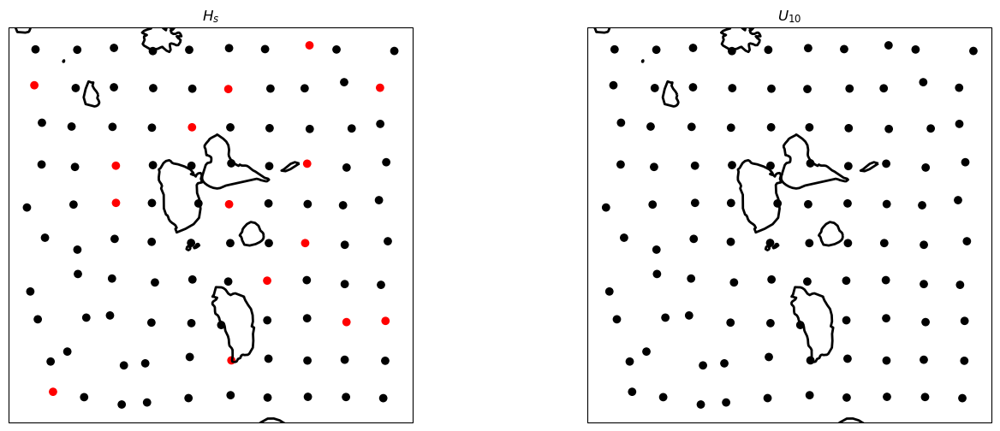

In [11]:
fig, ax = plt.subplots(
    1,
    num_vars,
    figsize=(8 * 2, 6),
    subplot_kw={"projection": ccrs.PlateCarree()},
)
for S in STM:
    vi = S.idx()
    _c = ["red" if p < 0.05 else "black" for p in pval_array[vi]]
    ax[vi].coastlines(lw=2)
    ax[vi].scatter(
        longitude[pos_list],
        latitude[pos_list],
        c=_c,
    )
    ax[vi].set_title(f"{S.name()}")
    plt.savefig(path_out / f"pval_map.png", bbox_inches="tight")
    plt.savefig(path_out / f"pval_map.pdf", bbox_inches="tight")

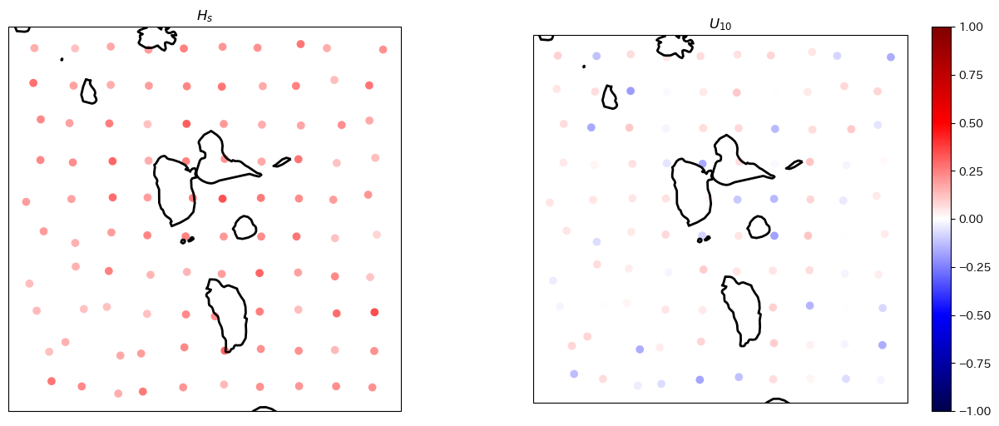

In [12]:
fig, ax = plt.subplots(
    1,
    num_vars,
    figsize=(8 * 2, 6),
    subplot_kw={"projection": ccrs.PlateCarree()},
)
for S in STM:
    vi = S.idx()
    ax[vi].coastlines(lw=2)
    im = ax[vi].scatter(
        longitude[pos_list],
        latitude[pos_list],
        c=tau_array[vi],
        cmap='seismic',
        vmin=-1,
        vmax=1,
    )
    ax[vi].set_title(f"{S.name()}")
    plt.savefig(path_out / f"tval_map.png", bbox_inches="tight")
    plt.savefig(path_out / f"tval_map.pdf", bbox_inches="tight")
plt.colorbar(im, ax=ax[1])

# Compare wind wave 2D histogram from original and subsample

In [15]:
path_mstme = Path(
    f"./output/{simset.region}/{simset.rf}/GP{thr_pct_mar}%_CM{thr_pct_com}%_{100}subsamples/mstme_condition.dill"
)
with open(path_mstme, "rb") as f:
    mstme_condition: MSTME = dill.load(f)
N_year_pool = 200
N_subsample = 1000
path_mstme_ss_dill = path_mstme.parent.joinpath(
    f"mstme_ss_{N_subsample}_pool_{N_year_pool}.dill"
)
if path_mstme_ss_dill.exists():
    with open(path_mstme_ss_dill, "rb") as f:
        tm_MSTME_ss, stm_MSTME_ss = dill.load(f)
    if tm_MSTME_ss.shape[0] != N_subsample:
        print(
            f"Sample count of {tm_MSTME_ss.shape[0]} for mstme_ss_dill does not match the input:{N_subsample} (GP{round(thr_pct_mar*100)}%_CM{round(thr_pct_com*100)}%)"
        )
else:
    try:
        tm_MSTME_ss, stm_MSTME_ss = mc.subsample_MSTME(
            mstme_condition,
            N_subsample,
            N_year_pool,
            pos_list=pos_list,
        )
        with path_mstme_ss_dill.open("wb") as f:
            dill.dump((tm_MSTME_ss, stm_MSTME_ss), f)
    except mc.SubsampleException as e:
        print(e)

rng = np.random.default_rng()


In [17]:
loc_i = 0
num_events_ext = np.count_nonzero(mstme.is_e_any)
exp_series_ext = [
    ds_exp_series[idx].isel(node=pos_list_5loc[loc_i])[['hs','UV_10m']] for idx in np.where(mstme.is_e_any)[0]
]
stm_ext = mstme.stm[:, mstme.is_e_any]
exp_array, exp_unique = es.quantize_exp(exp_series_ext, num_events_ext, res, use_temporal)
exp_array *= es.get_mask(res, {"type": mask_type, "threshold": mask_threshold})

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 3]
 [0 3]
 [0 3]
 [0 3]
 [0 3]
 [0 4]
 [0 4]
 [0 4]
 [0 4]
 [0 5]
 [1 5]
 [1 6]
 [1 6]
 [1 7]
 [1 7]
 [2 8]
 [2 8]
 [3 8]
 [3 8]
 [4 7]
 [4 8]
 [4 9]
 [4 9]
 [4 9]
 [5 8]
 [5 8]
 [5 7]
 [5 7]
 [5 6]
 [4 6]
 [4 5]
 [4 5]
 [4 4]
 [4 4]
 [3 4]
 [3 4]
 [3 3]
 [3 3]
 [3 3]
 [3 3]
 [3 2]
 [3 2]
 [3 2]
 [2 2]
 [2 2]
 [2 2]
 [2 2]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 0]
 [2 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]]
[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0

In [18]:
tdata=[]
for i in range(100*num_events_ext): 
  ssi = rng.choice(1000)
  _stm = rng.choice(stm_MSTME_ss[ssi,:,:],size=1,axis=1)
  _idx = rng.choice(num_events_ext)
  _exp_traj = exp_series_ext[_idx].to_array().values
  _tdata = _stm*_exp_traj
  tdata.append(_tdata)


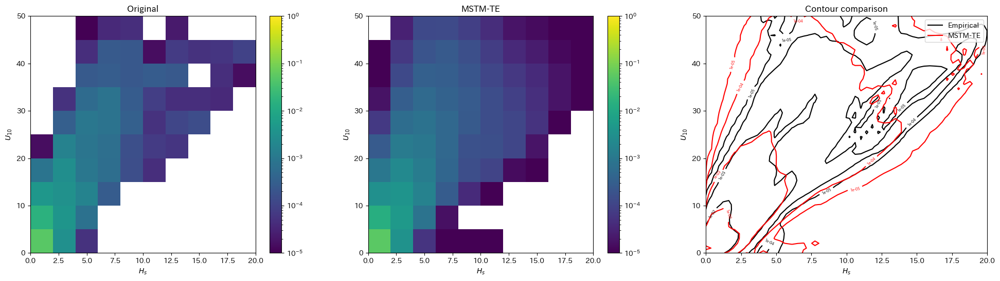

In [19]:
fig, axes = plt.subplots(1, 3, figsize=(8 * 3, 6), facecolor="white")

bounds = [[0, 20], [0, 50]]
axes[0].set_xlabel(STM.H.name())
axes[0].set_ylabel(STM.U.name())
axes[0].set_title("Original")
x = []
y = []
for ei in range(num_events_ext):
    x.extend(exp_series_ext[ei]["hs"].values.tolist() * stm_ext[0, ei].values)
    y.extend(exp_series_ext[ei]["UV_10m"].values.tolist() * stm_ext[1, ei].values)
h, xedges, yedges, image = axes[0].hist2d(
    x,
    y,
    density=True,
    range=bounds,
    # cmax=1e2
    norm=colors.LogNorm(1e-5, 1e0),
)
plt.colorbar(image, ax=axes[0])


axes[1].set_xlabel(STM.H.name())
axes[1].set_ylabel(STM.U.name())
axes[1].set_xlim(0, 25)
axes[1].set_ylim(0, 60)
axes[1].set_title("MSTM-TE")
x = []
y = []
for td in tdata:
    x.extend(td[0])
    y.extend(td[1])
h, xedges, yedges, image = axes[1].hist2d(
    x,
    y,
    density=True,
    range=bounds,
    # cmax=1e2
    norm=colors.LogNorm(1e-5, 1e0),
)
plt.colorbar(image, ax=axes[1])

axes[2].set_xlabel(STM.H.name())
axes[2].set_ylabel(STM.U.name())
axes[2].set_title("Original")
x = []
y = []
for ei in range(num_events_ext):
    x.extend(exp_series_ext[ei]["hs"].values.tolist() * stm_ext[0, ei].values)
    y.extend(exp_series_ext[ei]["UV_10m"].values.tolist() * stm_ext[1, ei].values)
nbins = 50
kde1 = gaussian_kde(np.array([x, y]))
xi, yi = np.mgrid[0 : 20 : nbins * 1j, 0 : 50 : nbins * 1j]
zi = kde1(np.vstack([xi.flatten(), yi.flatten()]))

levels = [10**i for i in np.arange(-5,0,1.0)]
im1=axes[2].contour(
    xi,
    yi,
    zi.reshape(xi.shape),
    # norm=colors.LogNorm(1e-5, 1e0),
    levels=levels,
    colors='black',
)
axes[2].clabel(im1,inline=True,fontsize=5,fmt='%1.0e')

axes[2].set_xlabel(STM.H.name())
axes[2].set_ylabel(STM.U.name())
axes[2].set_title("Contour comparison")
x = []
y = []
for td in tdata:
    x.extend(td[0])
    y.extend(td[1])
kde2 = gaussian_kde(np.array([x, y]))
zi = kde2(np.vstack([xi.flatten(), yi.flatten()]))
im2=axes[2].contour(
    xi,
    yi,
    zi.reshape(xi.shape),
    # norm=colors.LogNorm(1e-5, 1e0),
    levels=levels,
    colors='red',
)
axes[2].clabel(im2,inline=True,fontsize=5,fmt='%1.0e')

custom_lines = [
    Line2D([0], [0], color="k"),
    Line2D([0], [0], color="r")
]

# ax.legend(custom_lines, [f'{thr:.2f}'for thr in thr_com_list])
axes[2].legend(custom_lines, ["Empirical", "MSTM-TE"])

plt.savefig(path_out / f"MSTM-TE_comparison_{loc_i}_kde.png", bbox_inches="tight")
plt.savefig(path_out / f"MSTM-TE_comparison_{loc_i}_kde.pdf", bbox_inches="tight")

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 3]
 [0 3]
 [0 3]
 [0 3]
 [1 3]
 [1 4]
 [1 4]
 [1 4]
 [1 5]
 [1 5]
 [2 5]
 [2 6]
 [2 6]
 [3 7]
 [3 7]
 [4 8]
 [5 8]
 [5 9]
 [6 9]
 [6 9]
 [6 9]
 [5 9]
 [5 8]
 [4 8]
 [4 7]
 [4 7]
 [3 6]
 [3 6]
 [2 6]
 [2 5]
 [2 5]
 [2 4]
 [2 4]
 [1 4]
 [1 4]
 [1 3]
 [1 3]
 [1 3]
 [1 3]
 [1 2]
 [1 2]
 [1 2]
 [1 2]
 [1 2]
 [1 2]
 [0 2]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]]
[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0

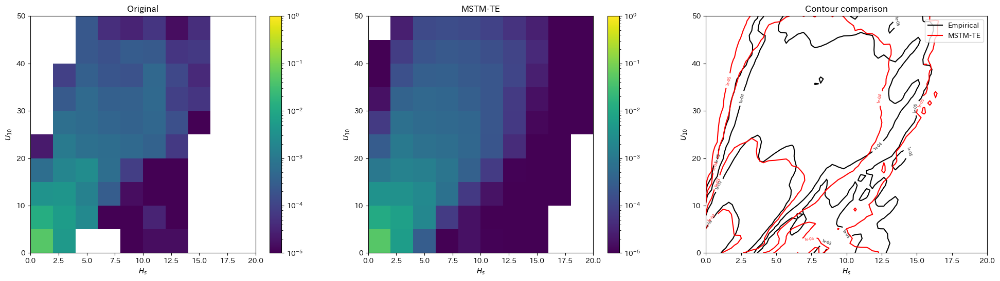

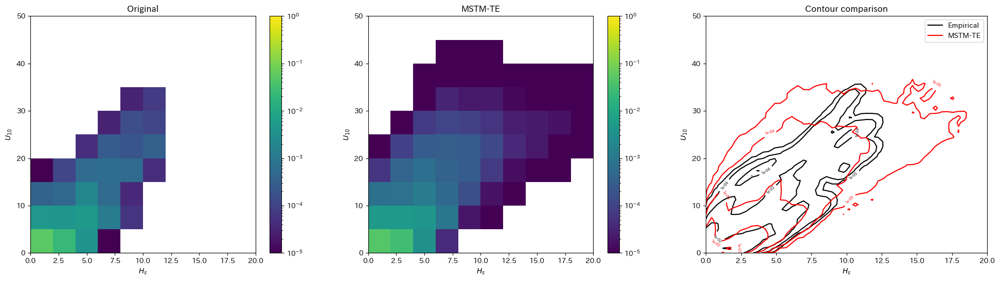

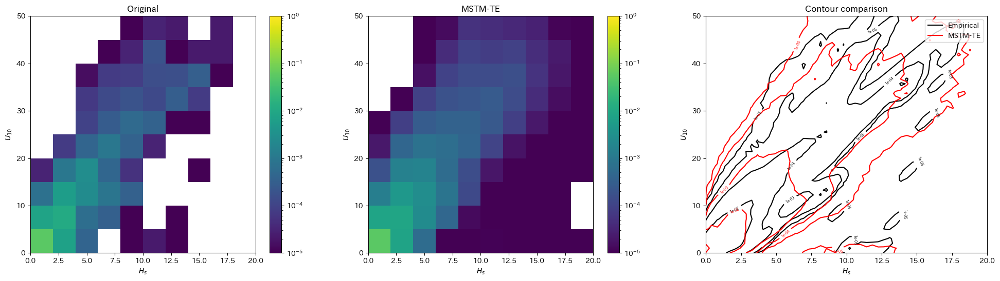

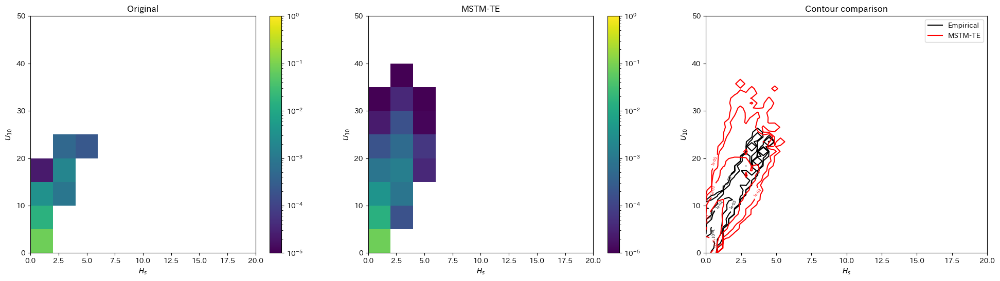

In [20]:
for loc_i in range(1,5):
    num_events_ext = np.count_nonzero(mstme.is_e_any)
    exp_series_ext = [
        ds_exp_series[idx].isel(node=pos_list_5loc[loc_i])[['hs','UV_10m']] for idx in np.where(mstme.is_e_any)[0]
    ]
    stm_ext = mstme.stm[:, mstme.is_e_any]
    exp_array, exp_unique = es.quantize_exp(exp_series_ext, num_events_ext, res, use_temporal)
    exp_array *= es.get_mask(res, {"type": mask_type, "threshold": mask_threshold})
    tdata=[]
    for i in range(100*num_events_ext): 
        ssi = rng.choice(1000)
        _stm = rng.choice(stm_MSTME_ss[ssi,:,:],size=1,axis=1)
        _idx = rng.choice(num_events_ext)
        _exp_traj = exp_series_ext[_idx].to_array().values
        _tdata = _stm*_exp_traj
        tdata.append(_tdata)

    fig, axes = plt.subplots(1, 3, figsize=(8 * 3, 6), facecolor="white")

    bounds = [[0, 20], [0, 50]]
    axes[0].set_xlabel(STM.H.name())
    axes[0].set_ylabel(STM.U.name())
    axes[0].set_title("Original")
    x = []
    y = []
    for ei in range(num_events_ext):
        x.extend(exp_series_ext[ei]["hs"].values.tolist() * stm_ext[0, ei].values)
        y.extend(exp_series_ext[ei]["UV_10m"].values.tolist() * stm_ext[1, ei].values)
    h, xedges, yedges, image = axes[0].hist2d(
        x,
        y,
        density=True,
        range=bounds,
        # cmax=1e2
        norm=colors.LogNorm(1e-5, 1e0),
    )
    plt.colorbar(image, ax=axes[0])


    axes[1].set_xlabel(STM.H.name())
    axes[1].set_ylabel(STM.U.name())
    axes[1].set_xlim(0, 25)
    axes[1].set_ylim(0, 60)
    axes[1].set_title("MSTM-TE")
    x = []
    y = []
    for td in tdata:
        x.extend(td[0])
        y.extend(td[1])
    h, xedges, yedges, image = axes[1].hist2d(
        x,
        y,
        density=True,
        range=bounds,
        # cmax=1e2
        norm=colors.LogNorm(1e-5, 1e0),
    )
    plt.colorbar(image, ax=axes[1])

    axes[2].set_xlabel(STM.H.name())
    axes[2].set_ylabel(STM.U.name())
    axes[2].set_title("Original")
    x = []
    y = []
    for ei in range(num_events_ext):
        x.extend(exp_series_ext[ei]["hs"].values.tolist() * stm_ext[0, ei].values)
        y.extend(exp_series_ext[ei]["UV_10m"].values.tolist() * stm_ext[1, ei].values)
    nbins = 50
    kde1 = gaussian_kde(np.array([x, y]))
    xi, yi = np.mgrid[0 : 20 : nbins * 1j, 0 : 50 : nbins * 1j]
    zi = kde1(np.vstack([xi.flatten(), yi.flatten()]))

    levels = [10**i for i in np.arange(-5,0,1.0)]
    im1=axes[2].contour(
        xi,
        yi,
        zi.reshape(xi.shape),
        # norm=colors.LogNorm(1e-5, 1e0),
        levels=levels,
        colors='black',
    )
    axes[2].clabel(im1,inline=True,fontsize=5,fmt='%1.0e')

    axes[2].set_xlabel(STM.H.name())
    axes[2].set_ylabel(STM.U.name())
    axes[2].set_title("Contour comparison")
    x = []
    y = []
    for td in tdata:
        x.extend(td[0])
        y.extend(td[1])
    kde2 = gaussian_kde(np.array([x, y]))
    zi = kde2(np.vstack([xi.flatten(), yi.flatten()]))
    im2=axes[2].contour(
        xi,
        yi,
        zi.reshape(xi.shape),
        # norm=colors.LogNorm(1e-5, 1e0),
        levels=levels,
        colors='red',
    )
    axes[2].clabel(im2,inline=True,fontsize=5,fmt='%1.0e')

    custom_lines = [
        Line2D([0], [0], color="k"),
        Line2D([0], [0], color="r")
    ]

    # ax.legend(custom_lines, [f'{thr:.2f}'for thr in thr_com_list])
    axes[2].legend(custom_lines, ["Empirical", "MSTM-TE"])

    plt.savefig(path_out / f"MSTM-TE_comparison_{loc_i}_kde.png", bbox_inches="tight")
    plt.savefig(path_out / f"MSTM-TE_comparison_{loc_i}_kde.pdf", bbox_inches="tight")

## Fixed subsample

In [21]:
tdata=[]
ssi = 500
for i in range(100*num_events_ext):
  _stm = rng.choice(stm_MSTME_ss[ssi,:,:],size=1,axis=1)
  _idx = rng.choice(num_events_ext)
  _exp_traj = exp_series_ext[_idx].to_array().values
  _tdata = _stm*_exp_traj
  tdata.append(_tdata)


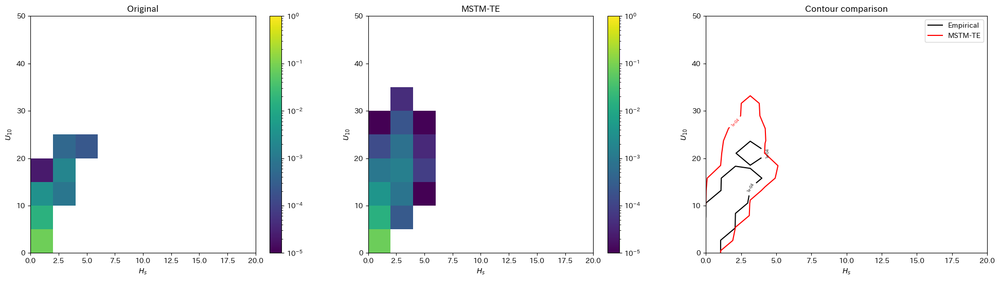

In [22]:
fig, axes = plt.subplots(1, 3, figsize=(8 * 3, 6), facecolor="white")

bounds = [[0, 20], [0, 50]]
axes[0].set_xlabel(STM.H.name())
axes[0].set_ylabel(STM.U.name())
axes[0].set_title("Original")
x = []
y = []
for ei in range(num_events_ext):
    x.extend(exp_series_ext[ei]["hs"].values.tolist() * stm_ext[0, ei].values)
    y.extend(exp_series_ext[ei]["UV_10m"].values.tolist() * stm_ext[1, ei].values)
h, xedges, yedges, image = axes[0].hist2d(
    x,
    y,
    density=True,
    range=bounds,
    # cmax=1e2
    norm=colors.LogNorm(1e-5, 1e0),
)
plt.colorbar(image, ax=axes[0])


axes[1].set_xlabel(STM.H.name())
axes[1].set_ylabel(STM.U.name())
axes[1].set_xlim(0, 25)
axes[1].set_ylim(0, 60)
axes[1].set_title("MSTM-TE")
x = []
y = []
for td in tdata:
    x.extend(td[0])
    y.extend(td[1])
h, xedges, yedges, image = axes[1].hist2d(
    x,
    y,
    density=True,
    range=bounds,
    # cmax=1e2
    norm=colors.LogNorm(1e-5, 1e0),
)
plt.colorbar(image, ax=axes[1])

axes[2].set_xlabel(STM.H.name())
axes[2].set_ylabel(STM.U.name())
axes[2].set_title("Original")
x = []
y = []
for ei in range(num_events_ext):
    x.extend(exp_series_ext[ei]["hs"].values.tolist() * stm_ext[0, ei].values)
    y.extend(exp_series_ext[ei]["UV_10m"].values.tolist() * stm_ext[1, ei].values)
nbins = 20
kde1 = gaussian_kde(np.array([x, y]))
xi, yi = np.mgrid[0 : 20 : nbins * 1j, 0 : 50 : nbins * 1j]
zi = kde1(np.vstack([xi.flatten(), yi.flatten()]))

levels = [10**i for i in [-4]]
# levels = [10**i for i in np.arange(-6,0,1.0)]
im1=axes[2].contour(
    xi,
    yi,
    zi.reshape(xi.shape),
    # norm=colors.LogNorm(1e-5, 1e0),
    levels=levels,
    colors='black',
)
axes[2].clabel(im1,inline=True,fontsize=5,fmt='%1.0e')

axes[2].set_xlabel(STM.H.name())
axes[2].set_ylabel(STM.U.name())
axes[2].set_title("Contour comparison")
x = []
y = []
for td in tdata:
    x.extend(td[0])
    y.extend(td[1])
kde2 = gaussian_kde(np.array([x, y]))
zi = kde2(np.vstack([xi.flatten(), yi.flatten()]))
im2=axes[2].contour(
    xi,
    yi,
    zi.reshape(xi.shape),
    # norm=colors.LogNorm(1e-5, 1e0),
    levels=levels,
    colors='red',
)
axes[2].clabel(im2,inline=True,fontsize=5,fmt='%1.0e')

custom_lines = [
    Line2D([0], [0], color="k"),
    Line2D([0], [0], color="r")
]

# ax.legend(custom_lines, [f'{thr:.2f}'for thr in thr_com_list])
axes[2].legend(custom_lines, ["Empirical", "MSTM-TE"])

plt.savefig(path_out / f"MSTM-TE_comparison_{loc_i}_kde_fixed.png", bbox_inches="tight")
plt.savefig(path_out / f"MSTM-TE_comparison_{loc_i}_kde_fixed.pdf", bbox_inches="tight")

## Uncertainty

C:\Users\Kosuke\AppData\Local\Temp\ipykernel_22628\2628676974.py:60: UserWarning: No contour levels were found within the data range.
  im1 = axes[2].contour(
C:\Users\Kosuke\AppData\Local\Temp\ipykernel_22628\2628676974.py:86: UserWarning: No contour levels were found within the data range.
  im2 = axes[2].contour(


KeyboardInterrupt: 

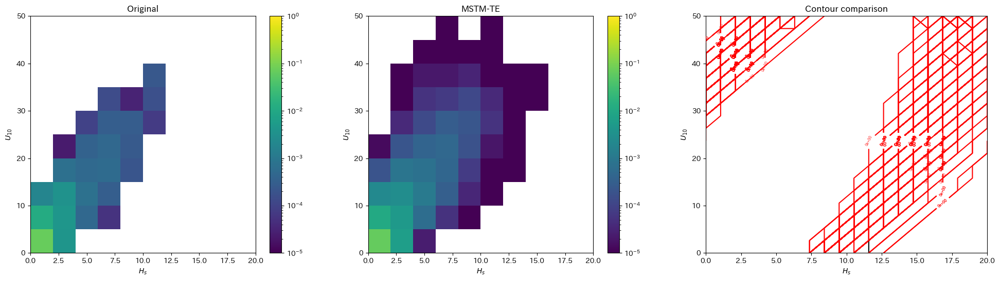

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(8 * 3, 6), facecolor="white")

bounds = [[0, 20], [0, 50]]
axes[0].set_xlabel(STM.H.name())
axes[0].set_ylabel(STM.U.name())
axes[0].set_title("Original")
x = []
y = []
for ei in range(num_events_ext):
    x.extend(exp_series_ext[ei]["hs"].values.tolist() * stm_ext[0, ei].values)
    y.extend(exp_series_ext[ei]["UV_10m"].values.tolist() * stm_ext[1, ei].values)
h, xedges, yedges, image = axes[0].hist2d(
    x,
    y,
    density=True,
    range=bounds,
    # cmax=1e2
    norm=colors.LogNorm(1e-5, 1e0),
)
plt.colorbar(image, ax=axes[0])


axes[1].set_xlabel(STM.H.name())
axes[1].set_ylabel(STM.U.name())
axes[1].set_xlim(0, 25)
axes[1].set_ylim(0, 60)
axes[1].set_title("MSTM-TE")
x = []
y = []
for td in tdata:
    x.extend(td[0])
    y.extend(td[1])
h, xedges, yedges, image = axes[1].hist2d(
    x,
    y,
    density=True,
    range=bounds,
    # cmax=1e2
    norm=colors.LogNorm(1e-5, 1e0),
)
plt.colorbar(image, ax=axes[1])


#########
axes[2].set_xlabel(STM.H.name())
axes[2].set_ylabel(STM.U.name())
axes[2].set_title("Contour comparison")

x = []
y = []
for ei in range(num_events_ext):
    x.extend(exp_series_ext[ei]["hs"].values.tolist() * stm_ext[0, ei].values)
    y.extend(exp_series_ext[ei]["UV_10m"].values.tolist() * stm_ext[1, ei].values)
nbins = 20
kde1 = gaussian_kde(np.array([x, y]))
xi, yi = np.mgrid[0 : 20 : nbins * 1j, 0 : 50 : nbins * 1j]
zi = kde1(np.vstack([xi.flatten(), yi.flatten()]))

levels = [10**i for i in []]
im1 = axes[2].contour(
    xi,
    yi,
    zi.reshape(xi.shape),
    # norm=colors.LogNorm(1e-5, 1e0),
    levels=levels,
    colors="black",
)
axes[2].clabel(im1, inline=True, fontsize=5, fmt="%1.0e")

for ssi in range(1000):
    tdata = []
    for i in range(100 * num_events_ext):
        _stm = rng.choice(stm_MSTME_ss[ssi, :, :], size=1, axis=1)
        _idx = rng.choice(num_events_ext)
        _exp_traj = exp_series_ext[_idx].to_array().values
        _tdata = _stm * _exp_traj
        tdata.append(_tdata)

    x = []
    y = []
    for td in tdata:
        x.extend(td[0])
        y.extend(td[1])
    kde2 = gaussian_kde(np.array([x, y]))
    zi = kde2(np.vstack([xi.flatten(), yi.flatten()]))
    im2 = axes[2].contour(
        xi,
        yi,
        zi.reshape(xi.shape),
        # norm=colors.LogNorm(1e-5, 1e0),
        levels=levels,
        colors="red",
    )
    axes[2].clabel(im2, inline=True, fontsize=5, fmt="%1.0e")

custom_lines = [Line2D([0], [0], color="k"), Line2D([0], [0], color="r")]

# ax.legend(custom_lines, [f'{thr:.2f}'for thr in thr_com_list])
axes[2].legend(custom_lines, ["Empirical", "MSTM-TE"])

plt.savefig(path_out / f"MSTM-TE_comparison_{loc_i}_kde_variance.png", bbox_inches="tight")
plt.savefig(path_out / f"MSTM-TE_comparison_{loc_i}_kde_variance.pdf", bbox_inches="tight")

## Just exposure

In [22]:
texp=[]
for i in range(1000):
  _idx = rng.choice(num_events_ext)
  _exp_traj = exp_series_ext[_idx].to_array().values
  texp.append(_exp_traj)

In [23]:
exp_series_ext[_idx].to_array().values

array([[0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.00051177,
        0.00051177, 0.00102354, 0.00102354, 0.00102354, 0.00153531,
        0.00153531, 0.00153531, 0.00153531, 0.00204708, 0.00255885,
        0.00307062, 0.00409417, 0.00562948, 0.00767656, 0.0087001 ,
        0.0087001 , 0.0087001 , 0.00921187, 0.00972364, 0.01074719,
        0.0122825 , 0.01381781, 0.01586489, 0.01842375, 0.02149437,
        0.02507677, 0.0296827 , 0.03531218, 0.04145343, 0.04810645,
        0.05527124, 0.0629478 , 0.07062437, 0.0788127 , 0.08597749,
        0.09314227, 0.09877175, 0.10388946, 0.11156603, 0.12077789,
        0.129478  , 0.13817811, 0.14636643, 0.15

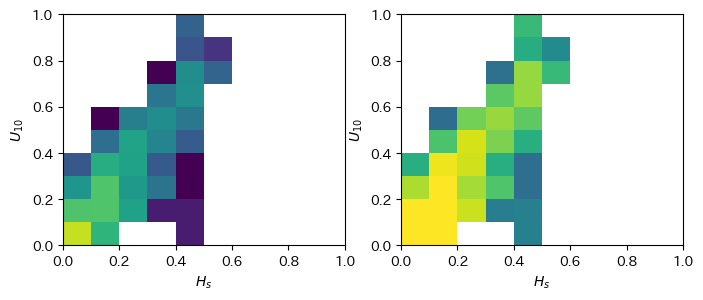

In [24]:
fig, axes = plt.subplots(1, 2, figsize=(4*2, 3), facecolor="white")

bounds=[[0, 1], [0, 1]]
axes[0].set_xlabel(STM.H.name())
axes[0].set_ylabel(STM.U.name())
x = []
y = []
for ei in range(num_events_ext):
    x.extend(exp_series_ext[ei]["hs"].values.tolist())
    y.extend(exp_series_ext[ei]["UV_10m"].values.tolist())
h,xedges,yedges,image = axes[0].hist2d(
    x,
    y,
    range=bounds,
    # cmax=1e2
    norm = colors.LogNorm(1e-0,1e4),
)
# plt.colorbar(image)


axes[1].set_xlabel(STM.H.name())
axes[1].set_ylabel(STM.U.name())
axes[1].set_xlim(0,25)
axes[1].set_ylim(0,60)
x = []
y = []
for td in texp:
    x.extend(td[0])
    y.extend(td[1])
h,xedges,yedges,image = axes[1].hist2d(
    x,
    y,
    range=bounds,
    # cmax=1e2
    norm = colors.LogNorm(1e-0,1e4),
)


# plt.colorbar(image)

# Stuff for explanation

## Quantize

In [23]:
loc_i = 0
num_events_ext = np.count_nonzero(mstme.is_e_any)
exp_series_ext = [
    ds_exp_series[idx].isel(node=pos_list_5loc[loc_i])[['hs','UV_10m']] for idx in np.where(mstme.is_e_any)[0]
]
stm_ext = mstme.stm[:, mstme.is_e_any]
exp_array, exp_unique = es.quantize_exp(exp_series_ext, num_events_ext, res, use_temporal)
exp_array *= es.get_mask(res, {"type": mask_type, "threshold": mask_threshold})

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 1]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 2]
 [0 3]
 [0 3]
 [0 3]
 [0 3]
 [0 3]
 [0 4]
 [0 4]
 [0 4]
 [0 4]
 [0 5]
 [1 5]
 [1 6]
 [1 6]
 [1 7]
 [1 7]
 [2 8]
 [2 8]
 [3 8]
 [3 8]
 [4 7]
 [4 8]
 [4 9]
 [4 9]
 [4 9]
 [5 8]
 [5 8]
 [5 7]
 [5 7]
 [5 6]
 [4 6]
 [4 5]
 [4 5]
 [4 4]
 [4 4]
 [3 4]
 [3 4]
 [3 3]
 [3 3]
 [3 3]
 [3 3]
 [3 2]
 [3 2]
 [3 2]
 [2 2]
 [2 2]
 [2 2]
 [2 2]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 1]
 [2 0]
 [2 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]]
[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0

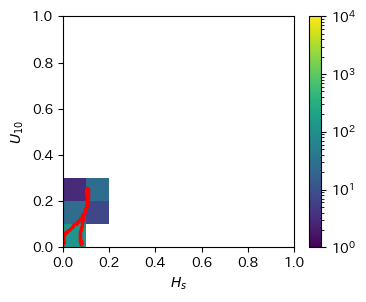

In [24]:
fig, ax = plt.subplots(1, 1, figsize=(4, 3), facecolor="white")
ei = 2
ax.set_aspect('equal')
ax.set_xlabel(STM.H.name())
ax.set_ylabel(STM.U.name())
_,_,_,im=ax.hist2d(
    exp_series_ext[ei]["hs"].values.tolist(),
    exp_series_ext[ei]["UV_10m"].values.tolist(),
    range=[[0,1],[0,1]],
    bins=10,
    norm=colors.LogNorm(1e0,1e4)
)
ax.scatter(
    exp_series_ext[ei]["hs"].values.tolist(),
    exp_series_ext[ei]["UV_10m"].values.tolist(),
    s=2,
    c='red',
)
plt.colorbar(im)

plt.savefig(path_out/f"quantize_{loc_i}.pdf")
plt.savefig(path_out/f"quantize_{loc_i}.png")

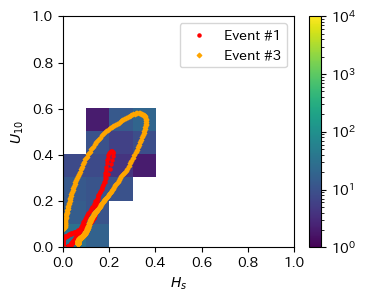

In [25]:
fig, ax = plt.subplots(1, 1, figsize=(4, 3), facecolor="white")
ei = 1
dei=2
ax.set_aspect("equal")
ax.set_xlabel(STM.H.name())
ax.set_ylabel(STM.U.name())
# _, _, _, im = ax.hist2d(
#     exp_series_ext[ei]["hs"].values.tolist(),
#     exp_series_ext[ei]["UV_10m"].values.tolist(),
#     range=[[0, 1], [0, 1]],
#     bins=10,
#     norm=colors.LogNorm(1e0, 1e4),
# )

im=ax.imshow(
    np.abs(exp_array[ei] - exp_array[ei + dei]).T,
    origin="lower",
    extent=(0,1,0,1),
    norm=colors.LogNorm(1e0, 1e4),
)

ax.scatter(
    exp_series_ext[ei]["hs"].values.tolist(),
    exp_series_ext[ei]["UV_10m"].values.tolist(),
    s=5,
    c="red",
    marker='o',
    label=f"Event #{ei}"
)
ax.scatter(
    exp_series_ext[ei+dei]["hs"].values.tolist(),
    exp_series_ext[ei+dei]["UV_10m"].values.tolist(),
    s=5,
    c="orange",
    marker='D',
    label=f"Event #{ei+dei}"
)
ax.legend()
plt.colorbar(im)

plt.savefig(path_out / f"quantize_diff{loc_i}.pdf")
plt.savefig(path_out / f"quantize_diff{loc_i}.png")